# Looking at cell2location mapping of cell states from SN + multiome RNa-seq atlas of donor P13 states

## To evaluate the correctness of invading trophoblast annotation

Here:

- mapping of SN+multiome nuclei states of invading troph + other states from older SN atlas (only first 4 samples of donor P13)
- mapping of SN (new and full) nuclei states of invading troph + other states from older SN atlas (only first 4 samples of donor P13)

#### Takeaway: the following run of cell2location was the best and should be used further: 
`/lustre/scratch117/cellgen/team292/aa22/cell2loc_files/in_vivo_onto_in_vivo_mapping/results/20211123_P13_new_full_atlas_SN_and_multiome_updated_onto_all_relevant_Visium_chips_with_LF_gene_filter/cell2location_map/`


11.2021

In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
import anndata
import matplotlib.pyplot as plt

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.5
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyterlab_server   2.3.0
kiwisolver          1.3.1


In [4]:
%%bash

pip freeze

absl-py==0.12.0
aiohttp==3.7.4.post0
airr==1.3.1
alabaster==0.7.12
alembic @ file:///home/conda/feedstock_root/build_artifacts/alembic_1613901514078/work
anndata @ file:///home/conda/feedstock_root/build_artifacts/anndata_1605539061264/work
annoy @ file:///home/conda/feedstock_root/build_artifacts/python-annoy_1610271511811/work
anyio @ file:///home/conda/feedstock_root/build_artifacts/anyio_1614388751160/work/dist
arboreto==0.1.6
argon2-cffi @ file:///home/conda/feedstock_root/build_artifacts/argon2-cffi_1610522574055/work
async-generator==1.10
async-timeout==3.0.1
attrs @ file:///home/conda/feedstock_root/build_artifacts/attrs_1605083924122/work
Babel @ file:///home/conda/feedstock_root/build_artifacts/babel_1605182336601/work
backcall @ file:///home/conda/feedstock_root/build_artifacts/backcall_1592338393461/work
backports.functools-lru-cache==1.6.1
bbknn @ file:///opt/conda/conda-bld/bbknn_1616434096000/work
bleach @ file:///home/conda/feedstock_root/build_artifacts/bleach_16122134

# Reading in Visium data for donor P13

In [5]:
# reading adatas for scanpy plotting
IDs_P13 = ['64','65','66','67']

adatas_P13 = {}

for ID in IDs_P13:
    print(ID)
    # pre-mRNA
    adatas_P13[ID] = sc.read_visium('/lustre/scratch117/cellgen/team292/aa22/data/202008_MFI_Visium/20200901_new_data_spaceranger110/spaceranger110_count_34914_WS_PLA_S91017' + ID + '_GRCh38-3_0_0-premrna/')
    adatas_P13[ID].var_names_make_unique()

reading /lustre/scratch117/cellgen/team292/aa22/data/202008_MFI_Visium/20200901_new_data_spaceranger110/spaceranger110_count_34914_WS_PLA_S9101764_GRCh38-3_0_0-premrna/filtered_feature_bc_matrix.h5


64


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading /lustre/scratch117/cellgen/team292/aa22/data/202008_MFI_Visium/20200901_new_data_spaceranger110/spaceranger110_count_34914_WS_PLA_S9101765_GRCh38-3_0_0-premrna/filtered_feature_bc_matrix.h5


65


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading /lustre/scratch117/cellgen/team292/aa22/data/202008_MFI_Visium/20200901_new_data_spaceranger110/spaceranger110_count_34914_WS_PLA_S9101766_GRCh38-3_0_0-premrna/filtered_feature_bc_matrix.h5


66


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
reading /lustre/scratch117/cellgen/team292/aa22/data/202008_MFI_Visium/20200901_new_data_spaceranger110/spaceranger110_count_34914_WS_PLA_S9101767_GRCh38-3_0_0-premrna/filtered_feature_bc_matrix.h5


67


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:00)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [6]:
# adding QC metrics to the visium objects
for ID in IDs_P13:
    adatas_P13[ID].obs['n_counts'] = adatas_P13[ID].X.sum(1)
    adatas_P13[ID].obs['log_counts'] = np.log(adatas_P13[ID].obs['n_counts'])
    adatas_P13[ID].obs['n_genes'] = (adatas_P13[ID].X > 0).sum(1)
    
    mito_genes = [name for name in adatas_P13[ID].var_names if name.startswith('MT-')]
    #for each cell compute fraction of counts in mito genes vs. all genes
    #the `.A1` is only necessary, as X is sparse - it transform to a dense array after summing
    adatas_P13[ID].obs['percent_mito'] = np.sum(
        adatas_P13[ID][:, mito_genes].X, axis=1).A1 / np.sum(adatas_P13[ID].X, axis=1).A1
    # saving raw counts in .raw for now
    adatas_P13[ID].raw = adatas_P13[ID].copy()

In [7]:
adatas_P13['64']

AnnData object with n_obs × n_vars = 3568 × 33538
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'log_counts', 'n_genes', 'percent_mito'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

### Reading in cell2location results

latest runs with the most up-to-date cell2location environment and tutorial

using pre-mRNA aligned Visium

with soupy gene filtering (LF approach)

and 30 cells/spot - may be too much (?)

In [8]:
# mapping of SN+multiome nuclei states of invading troph + other states from older SN atlas (only first 4 samples of donor P13) onto 4 main P13 Visium chips

path = '/lustre/scratch117/cellgen/team292/aa22/cell2loc_files/results/20211109_analysis_inv_troph_from_new_full_altas_scvi_annot_and_rest_from_old_atlas_with_LF_gene_filter/cell2location_map/'

# object with all used Visium chips concatenated (in this case 4 main Visium chips)
sp_mapping = sc.read(path + 'sp.h5ad')



In [9]:
sp_mapping

AnnData object with n_obs × n_vars = 15488 × 13691
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'batch', 'spotID', '_scvi_batch', '_scvi_labels', '_indices'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: '_scvi', 'mod'
    obsm: 'means_cell_abundance_w_sf', 'q05_cell_abundance_w_sf', 'q95_cell_abundance_w_sf', 'spatial', 'stds_cell_abundance_w_sf'

In [10]:
sp_mapping.obsm['q05_cell_abundance_w_sf']

,q05cell_abundance_w_sf_DC1,q05cell_abundance_w_sf_EVT_1_scvi,q05cell_abundance_w_sf_EVT_2_scvi,q05cell_abundance_w_sf_Endo_F,q05cell_abundance_w_sf_Endo_L,q05cell_abundance_w_sf_Endo_M,q05cell_abundance_w_sf_GC?_scvi,q05cell_abundance_w_sf_HOFB,q05cell_abundance_w_sf_SCT,q05cell_abundance_w_sf_VCT,...,q05cell_abundance_w_sf_dNK1,q05cell_abundance_w_sf_dNK3,q05cell_abundance_w_sf_dPV,q05cell_abundance_w_sf_dS1,q05cell_abundance_w_sf_dS2/3,q05cell_abundance_w_sf_eEVT_scvi,q05cell_abundance_w_sf_fF,q05cell_abundance_w_sf_fPV,q05cell_abundance_w_sf_iEVT_scvi,q05cell_abundance_w_sf_uSMC
AAACAAGTATCTCCCA-1_WS_PLA_S9101764,0.924856,0.345529,0.840320,0.029933,1.660153,0.450347,3.166671,0.216296,0.074780,0.043932,...,0.308751,0.323053,1.613597,1.252878,0.912871,0.370132,0.067166,0.223806,4.161106,10.409556
AAACAATCTACTAGCA-1_WS_PLA_S9101764,1.365996,0.104334,0.018198,0.027083,3.379583,0.749647,2.917163,0.583404,0.002882,0.005665,...,0.141591,0.346972,5.599911,2.665234,0.179352,0.008547,0.221235,0.842802,0.017067,14.481301
AAACACCAATAACTGC-1_WS_PLA_S9101764,0.241978,0.016991,0.008697,0.007160,0.943554,0.311962,0.799956,0.094465,0.001106,0.001561,...,0.036847,0.093886,1.166797,0.768674,0.081766,0.004740,0.037639,0.147694,0.010134,11.064315
AAACAGAGCGACTCCT-1_WS_PLA_S9101764,0.140130,0.118375,0.429039,0.037315,0.755606,0.149676,0.553200,0.402993,0.043530,0.320235,...,0.234806,0.167218,0.435920,0.366305,1.737937,0.264532,0.041912,0.083955,1.974047,2.008611
AAACAGCTTTCAGAAG-1_WS_PLA_S9101764,3.094177,0.068440,0.017264,0.023112,2.860167,0.740040,2.666847,0.413505,0.001687,0.005460,...,0.151762,0.330313,4.795921,2.451376,0.298475,0.010187,0.213775,0.782374,0.016623,11.801730
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1_WS_PLA_S9101767,0.411779,0.452913,1.552265,0.038769,0.788624,0.228579,1.107489,0.245194,0.287981,0.228796,...,0.546847,0.321770,0.560732,0.605763,2.996479,0.897478,0.062760,0.118606,5.788728,1.885770
TTGTTTCACATCCAGG-1_WS_PLA_S9101767,0.004207,0.012122,0.017427,0.004106,0.011611,0.006575,0.016095,0.037131,0.049436,0.006122,...,0.016372,0.012187,0.006088,0.007292,0.358292,0.009824,0.002809,0.003873,0.063979,0.030024
TTGTTTCATTAGTCTA-1_WS_PLA_S9101767,0.004384,0.462293,0.070588,0.002108,0.023029,0.010422,0.025609,0.006791,0.005778,0.005844,...,0.015407,0.009522,0.035958,0.025386,0.120267,0.010629,0.010132,0.015866,0.039131,0.284889
TTGTTTCCATACAACT-1_WS_PLA_S9101767,0.004897,0.134023,0.264203,0.023259,0.013200,0.017907,0.014001,0.010359,0.842657,0.141393,...,0.023666,0.015920,0.007637,0.006491,0.267405,0.137930,0.040302,0.051776,0.145215,0.007658


In [11]:
'q05cell_abundance_w_sf_DC1'[18:]

'w_sf_DC1'

In [12]:
for ID in IDs_P13:
    print(ID)
    adatas_P13[ID].obs.index = [idx + '_WS_PLA_S91017' + ID for idx in adatas_P13[ID].obs.index]

64
65
66
67


In [13]:
for ID in IDs_P13:
    print(ID)
    for col in sp_mapping.obsm['q05_cell_abundance_w_sf']:
        col_chopped = col[18:]
        adatas_P13[ID].obs[col_chopped] = sp_mapping.obsm['q05_cell_abundance_w_sf'].loc[adatas_P13[ID].obs_names, col]

64
65
66
67


In [14]:
c2l_tags = [elem for elem in adatas_P13['64'].obs.columns if 'w_sf_' in elem]
c2l_tags

['w_sf_DC1',
 'w_sf_EVT_1_scvi',
 'w_sf_EVT_2_scvi',
 'w_sf_Endo_F',
 'w_sf_Endo_L',
 'w_sf_Endo_M',
 'w_sf_GC?_scvi',
 'w_sf_HOFB',
 'w_sf_SCT',
 'w_sf_VCT',
 'w_sf_VCT_CCC_scvi',
 'w_sf_VCT_fusing',
 'w_sf_VCT_p',
 'w_sf_dEpi_lumen',
 'w_sf_dEpi_secretory',
 'w_sf_dM2',
 'w_sf_dNK1',
 'w_sf_dNK3',
 'w_sf_dPV',
 'w_sf_dS1',
 'w_sf_dS2/3',
 'w_sf_eEVT_scvi',
 'w_sf_fF',
 'w_sf_fPV',
 'w_sf_iEVT_scvi',
 'w_sf_uSMC']

64


... storing 'feature_types' as categorical
... storing 'genome' as categorical


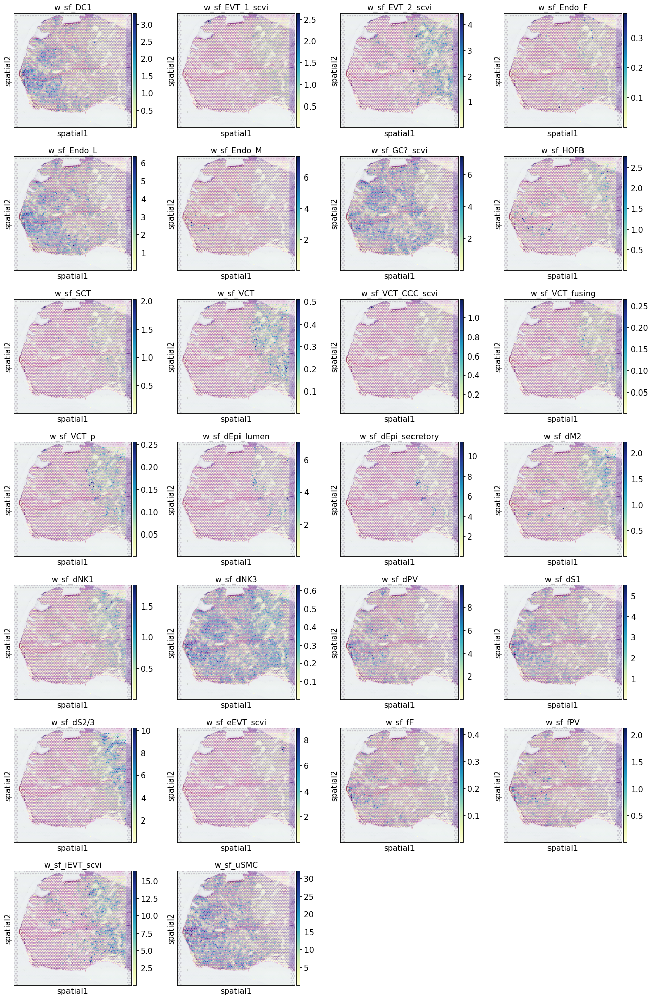

... storing 'feature_types' as categorical
... storing 'genome' as categorical


65


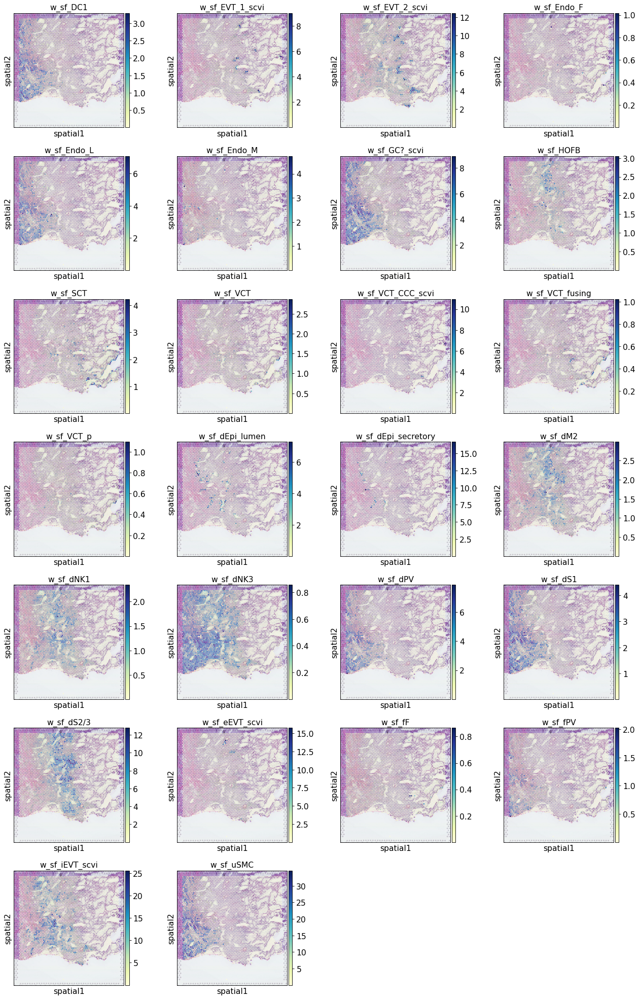

... storing 'feature_types' as categorical
... storing 'genome' as categorical


66


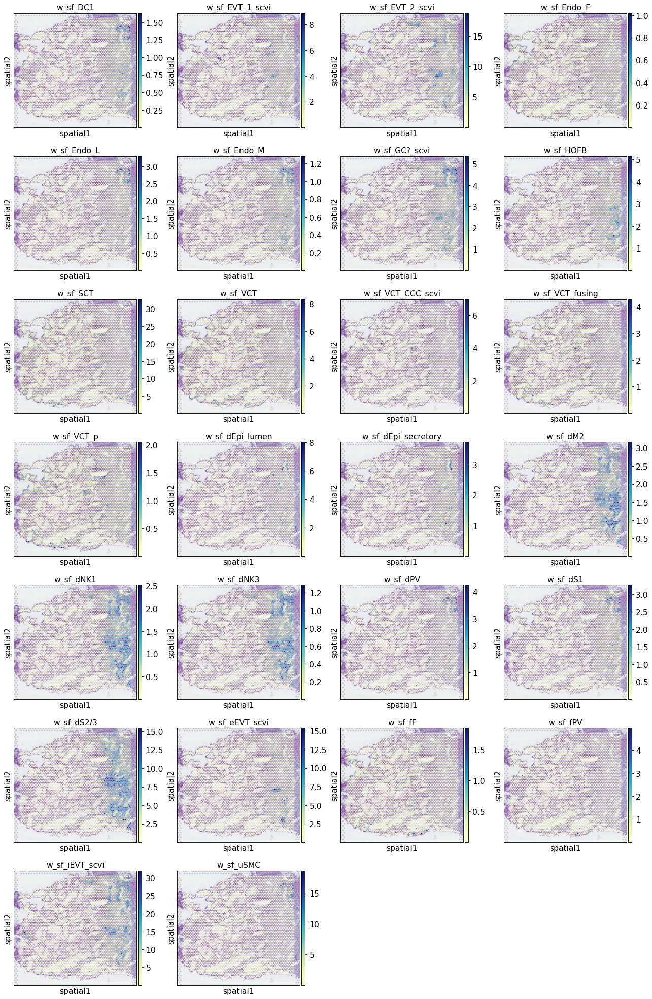

... storing 'feature_types' as categorical
... storing 'genome' as categorical


67


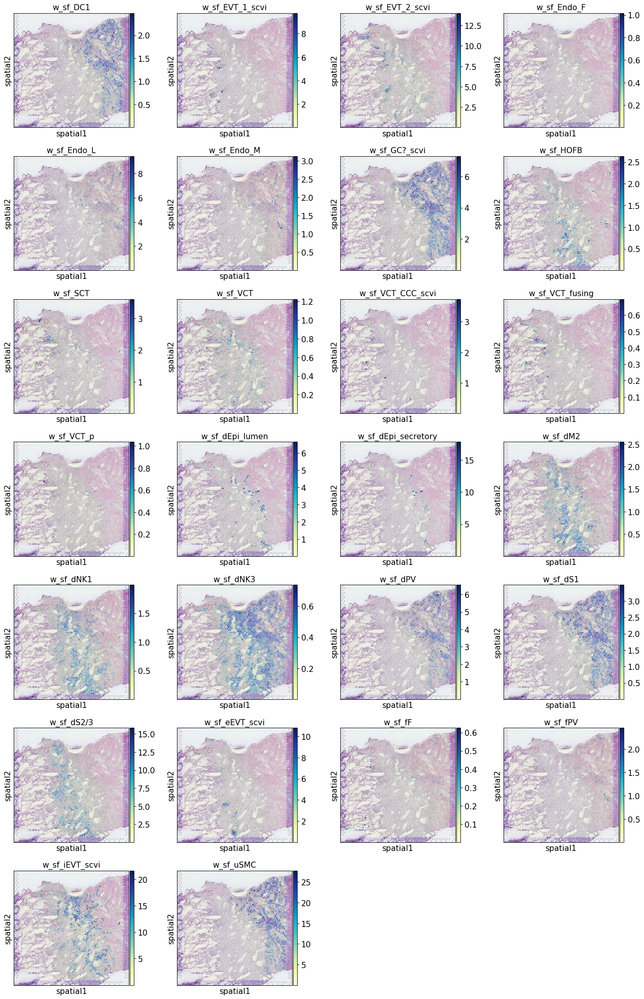

In [15]:
# plot

for ID in IDs_P13:
    print(ID)
    sc.pl.spatial(adatas_P13[ID],
                 color = c2l_tags, cmap='YlGnBu')

# YES! all inv troph states are located adequately here, maybe GC in slide 66 are not that early but still not bad
### also VCT_CCC are very modest everywhere - is this normal?

In [15]:
# mapping of SN (new and full) nuclei states of invading troph + other states from older SN atlas (only first 4 samples of donor P13) onto 4 main P13 Visium chips

path_sn_only = '/lustre/scratch117/cellgen/team292/aa22/cell2loc_files/results/20211109_analysis_inv_troph_from_new_full_altas_SN_only_scvi_annot_and_rest_from_old_atlas_with_LF_gene_filter/cell2location_map/'

# object with all used Visium chips concatenated (in this case 4 main Visium chips)
sp_mapping_sn_only = sc.read(path_sn_only + 'sp.h5ad')



In [16]:
sp_mapping_sn_only

AnnData object with n_obs × n_vars = 15488 × 13667
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'batch', 'spotID', '_scvi_batch', '_scvi_labels', '_indices'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: '_scvi', 'mod'
    obsm: 'means_cell_abundance_w_sf', 'q05_cell_abundance_w_sf', 'q95_cell_abundance_w_sf', 'spatial', 'stds_cell_abundance_w_sf'

In [17]:
sp_mapping_sn_only.obsm['q05_cell_abundance_w_sf']

,q05cell_abundance_w_sf_DC1,q05cell_abundance_w_sf_EVT_1_sn_only_scvi,q05cell_abundance_w_sf_EVT_2_sn_only_scvi,q05cell_abundance_w_sf_Endo_F,q05cell_abundance_w_sf_Endo_L,q05cell_abundance_w_sf_Endo_M,q05cell_abundance_w_sf_GC_sn_only_scvi,q05cell_abundance_w_sf_HOFB,q05cell_abundance_w_sf_SCT,q05cell_abundance_w_sf_VCT,...,q05cell_abundance_w_sf_dNK1,q05cell_abundance_w_sf_dNK3,q05cell_abundance_w_sf_dPV,q05cell_abundance_w_sf_dS1,q05cell_abundance_w_sf_dS2/3,q05cell_abundance_w_sf_eEVT_sn_only_scvi,q05cell_abundance_w_sf_fF,q05cell_abundance_w_sf_fPV,q05cell_abundance_w_sf_iEVT_sn_only_scvi,q05cell_abundance_w_sf_uSMC
AAACAAGTATCTCCCA-1_WS_PLA_S9101764,1.175328,0.521580,0.807305,0.036653,1.836393,0.470129,2.952349,0.237968,0.081643,0.059532,...,0.274362,0.299249,1.526936,1.080482,0.777751,0.188121,0.076801,0.275815,3.441259,10.146846
AAACAATCTACTAGCA-1_WS_PLA_S9101764,1.927592,0.033481,0.029706,0.034400,3.918401,0.669216,0.700850,0.580586,0.003216,0.007906,...,0.145262,0.407018,5.840485,2.348106,0.348525,0.055989,0.237669,1.100791,0.033657,14.311570
AAACACCAATAACTGC-1_WS_PLA_S9101764,0.362862,0.007465,0.011611,0.007430,1.090295,0.309991,0.190688,0.091496,0.001125,0.002027,...,0.036003,0.104892,1.325286,0.700054,0.155489,0.016501,0.046800,0.184105,0.016552,11.092361
AAACAGAGCGACTCCT-1_WS_PLA_S9101764,0.187036,0.194868,0.391393,0.044606,0.827018,0.180677,0.531111,0.468285,0.046211,0.306445,...,0.266763,0.179270,0.408472,0.370726,1.868657,0.108224,0.052875,0.095639,1.561766,1.974210
AAACAGCTTTCAGAAG-1_WS_PLA_S9101764,3.755155,0.025474,0.030325,0.023424,3.465509,0.689258,0.543825,0.407700,0.002658,0.008392,...,0.149582,0.376589,4.749810,2.091048,0.472627,0.076799,0.224868,0.921585,0.029657,11.807600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1_WS_PLA_S9101767,0.503994,0.962133,1.404913,0.051297,0.903819,0.289411,2.247661,0.297594,0.265716,0.257508,...,0.500029,0.309413,0.553987,0.647277,2.556824,0.235870,0.093971,0.128460,5.121222,1.877688
TTGTTTCACATCCAGG-1_WS_PLA_S9101767,0.005297,0.015783,0.017987,0.003071,0.009900,0.006198,0.040534,0.040893,0.047202,0.006622,...,0.023948,0.011941,0.004784,0.006751,0.415368,0.003415,0.002057,0.002943,0.049540,0.021597
TTGTTTCATTAGTCTA-1_WS_PLA_S9101767,0.005313,0.552353,0.043980,0.001973,0.022655,0.008356,0.018881,0.007604,0.004477,0.005493,...,0.019849,0.009312,0.030852,0.022880,0.192862,0.004280,0.010147,0.012025,0.037012,0.262212
TTGTTTCCATACAACT-1_WS_PLA_S9101767,0.007010,0.168571,0.216279,0.022297,0.014036,0.018723,0.029666,0.018620,0.780311,0.131902,...,0.035169,0.018550,0.008608,0.006021,0.361916,0.097440,0.034951,0.047932,0.121623,0.005852


In [18]:
for ID in IDs_P13:
    print(ID)
    #adatas_P13[ID].obs.index = [idx + '_WS_PLA_S91017' + ID for idx in adatas_P13[ID].obs.index]
    
    for col in sp_mapping_sn_only.obsm['q05_cell_abundance_w_sf']:
        col_chopped = col[18:] + '_sn_only'
        adatas_P13[ID].obs[col_chopped] = sp_mapping_sn_only.obsm['q05_cell_abundance_w_sf'].loc[adatas_P13[ID].obs_names, col]

64
65
66
67


In [20]:
c2l_tags_sn_only = [elem for elem in adatas_P13['64'].obs.columns if '_sn_only' in elem]
c2l_tags_sn_only

['w_sf_DC1_sn_only',
 'w_sf_EVT_1_sn_only_scvi_sn_only',
 'w_sf_EVT_2_sn_only_scvi_sn_only',
 'w_sf_Endo_F_sn_only',
 'w_sf_Endo_L_sn_only',
 'w_sf_Endo_M_sn_only',
 'w_sf_GC_sn_only_scvi_sn_only',
 'w_sf_HOFB_sn_only',
 'w_sf_SCT_sn_only',
 'w_sf_VCT_sn_only',
 'w_sf_VCT_CCC_sn_only_scvi_sn_only',
 'w_sf_VCT_fusing_sn_only',
 'w_sf_VCT_p_sn_only',
 'w_sf_dEpi_lumen_sn_only',
 'w_sf_dEpi_secretory_sn_only',
 'w_sf_dM2_sn_only',
 'w_sf_dNK1_sn_only',
 'w_sf_dNK3_sn_only',
 'w_sf_dPV_sn_only',
 'w_sf_dS1_sn_only',
 'w_sf_dS2/3_sn_only',
 'w_sf_eEVT_sn_only_scvi_sn_only',
 'w_sf_fF_sn_only',
 'w_sf_fPV_sn_only',
 'w_sf_iEVT_sn_only_scvi_sn_only',
 'w_sf_uSMC_sn_only']

64


... storing 'feature_types' as categorical
... storing 'genome' as categorical


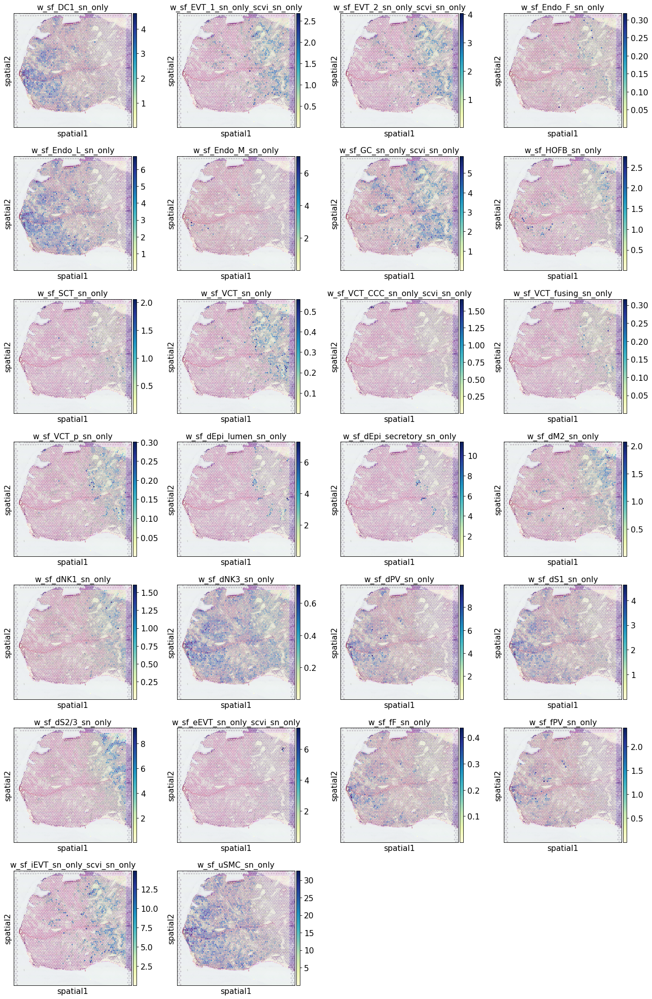

... storing 'feature_types' as categorical
... storing 'genome' as categorical


65


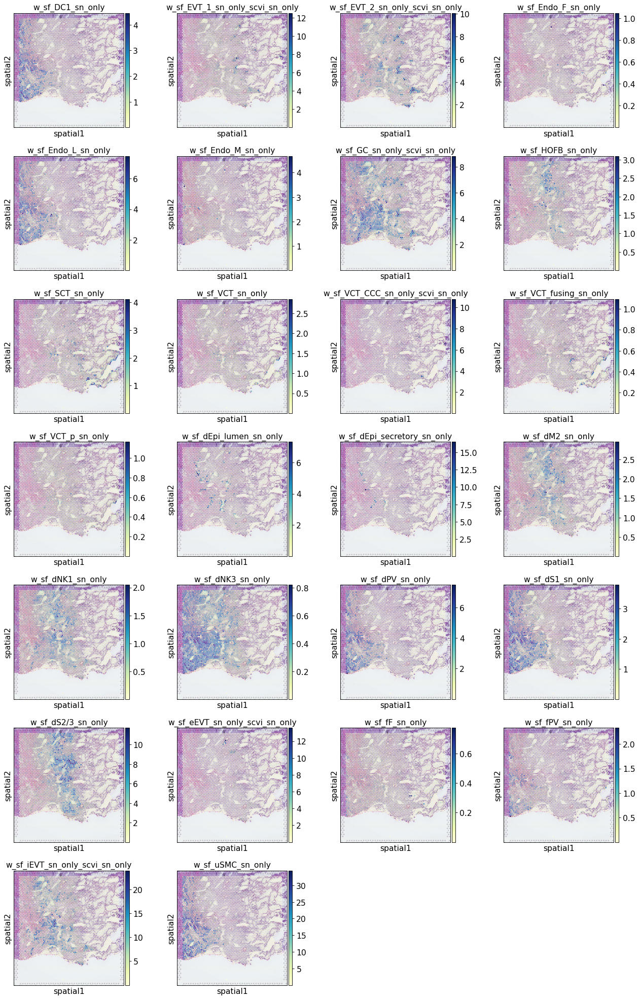

... storing 'feature_types' as categorical


66


... storing 'genome' as categorical


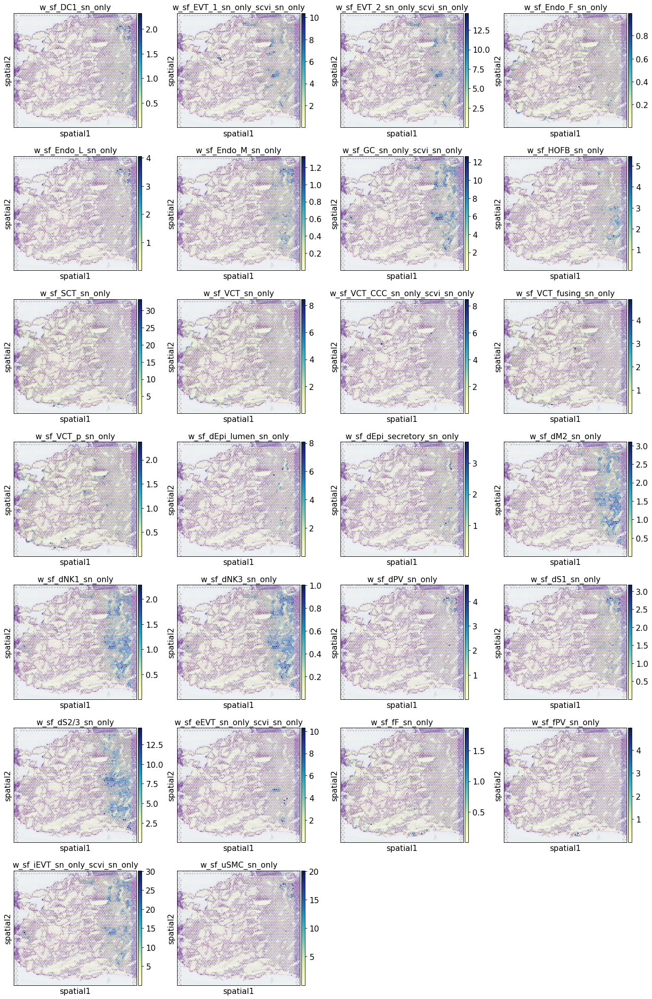

... storing 'feature_types' as categorical
... storing 'genome' as categorical


67


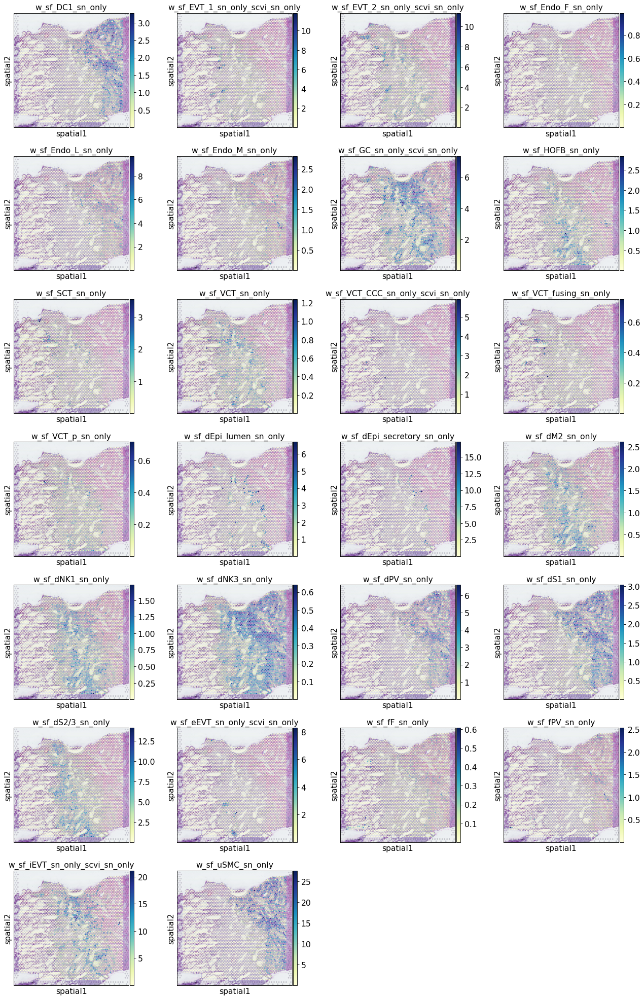

In [21]:
# plot

for ID in IDs_P13:
    print(ID)
    sc.pl.spatial(adatas_P13[ID],
                 color = c2l_tags_sn_only, cmap='YlGnBu')

# seems like preliminary GC based on SN only atlas (full) are a bit more messy

64


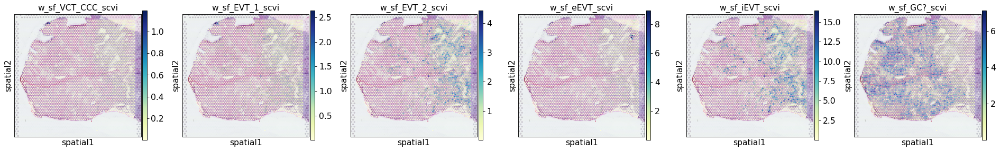

65


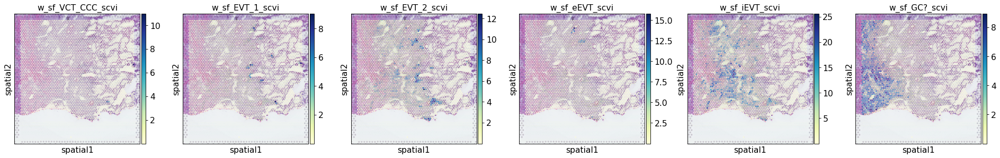

66


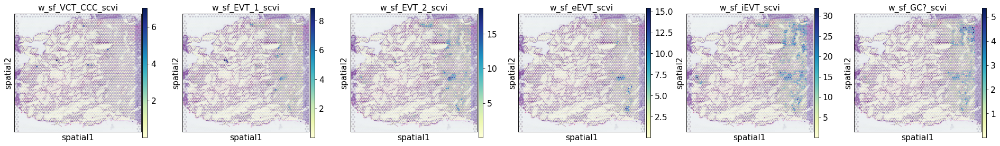

67


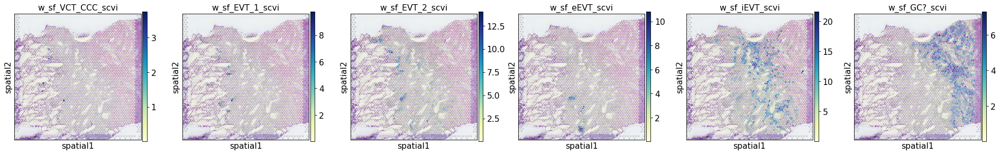

In [32]:
# plot only inv states, SN + multiome

for ID in IDs_P13:
    print(ID)
    sc.pl.spatial(adatas_P13[ID],
                 color = ['w_sf_VCT_CCC_scvi',
                          'w_sf_EVT_1_scvi',
                          'w_sf_EVT_2_scvi',
                          'w_sf_eEVT_scvi',
                          'w_sf_iEVT_scvi',
                          'w_sf_GC?_scvi'], cmap='YlGnBu', ncols=6)

# below is the final run to use

In [8]:
# final best run 

path = '/lustre/scratch117/cellgen/team292/aa22/cell2loc_files/in_vivo_onto_in_vivo_mapping/results/20211123_P13_new_full_atlas_SN_and_multiome_updated_onto_all_relevant_Visium_chips_with_LF_gene_filter/cell2location_map/'

# object with all used Visium chips concatenated (in this case 4 main Visium chips)
sp_mapping = sc.read(path + 'sp.h5ad')



In [9]:
sp_mapping

AnnData object with n_obs × n_vars = 27260 × 14476
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'barcode_sample', 'batch', 'spotID', '_scvi_batch', '_scvi_labels', '_indices'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: '_scvi', 'mod'
    obsm: 'means_cell_abundance_w_sf', 'q05_cell_abundance_w_sf', 'q95_cell_abundance_w_sf', 'spatial', 'stds_cell_abundance_w_sf'

In [10]:
sp_mapping.obsm['q05_cell_abundance_w_sf']

,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_DC,q05cell_abundance_w_sf_EVT_1,q05cell_abundance_w_sf_EVT_2,q05cell_abundance_w_sf_Endo_F,q05cell_abundance_w_sf_Endo_L,q05cell_abundance_w_sf_Endo_M,q05cell_abundance_w_sf_GC,q05cell_abundance_w_sf_Granulocytes,q05cell_abundance_w_sf_HOFB,...,q05cell_abundance_w_sf_dS1,q05cell_abundance_w_sf_dS2,q05cell_abundance_w_sf_dS3,q05cell_abundance_w_sf_dT_cells,q05cell_abundance_w_sf_dT_regs,q05cell_abundance_w_sf_eEVT,q05cell_abundance_w_sf_fF1,q05cell_abundance_w_sf_fF2,q05cell_abundance_w_sf_iEVT,q05cell_abundance_w_sf_uSMC
AAACAAGTATCTCCCA-1_34914_WS_PLA_S9101764,0.060838,0.146822,0.158687,0.851788,0.038806,0.746049,0.349208,3.027656,0.500839,0.061977,...,1.598067,0.131673,0.211407,0.075955,0.089355,0.154827,0.154210,0.067015,3.772072,10.303452
AAACAATCTACTAGCA-1_34914_WS_PLA_S9101764,0.071699,0.368816,0.013914,0.011455,0.080254,1.577463,0.714309,0.947956,1.248654,0.051251,...,4.373203,0.025892,0.250685,0.125899,0.160814,0.006453,0.457115,0.274455,0.010157,14.068544
AAACACCAATAACTGC-1_34914_WS_PLA_S9101764,0.015815,0.082095,0.001110,0.000398,0.015795,0.620762,0.313428,0.237711,0.258873,0.016365,...,1.267346,0.005608,0.046577,0.026094,0.037021,0.000772,0.124578,0.031312,0.000769,11.321204
AAACAGAGCGACTCCT-1_34914_WS_PLA_S9101764,0.033652,0.050152,0.045669,0.387620,0.044682,0.249089,0.103333,0.275922,0.075386,0.150781,...,0.286084,0.184628,1.776880,0.050005,0.044988,0.065874,0.042044,0.019016,2.247340,1.461058
AAACAGCTTTCAGAAG-1_34914_WS_PLA_S9101764,0.097381,0.389111,0.004886,0.002983,0.051698,1.420937,0.641310,0.660726,1.310447,0.074500,...,3.319809,0.029206,0.557351,0.106435,0.224961,0.002202,0.411167,0.138087,0.001726,11.918576
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1_36173_Pla_Camb9518737,0.019438,0.028318,0.161972,1.092586,0.020644,0.017452,0.063959,0.297090,0.010862,0.053996,...,0.051258,0.170513,0.583205,0.027985,0.019144,0.204748,0.016574,0.012625,2.994178,0.063708
TTGTTTCACATCCAGG-1_36173_Pla_Camb9518737,0.001759,0.004271,0.002581,0.026469,0.004719,0.003365,0.006640,0.000663,0.000336,0.035787,...,0.002373,0.018449,0.796988,0.002386,0.000934,0.008839,0.008699,0.006368,0.001758,0.002350
TTGTTTCATTAGTCTA-1_36173_Pla_Camb9518737,0.000322,0.001080,0.000446,0.013098,0.001566,0.001067,0.002376,0.002417,0.000170,0.001754,...,0.001357,0.002322,0.095372,0.000757,0.000285,0.008536,0.001380,0.001197,0.009167,0.001142
TTGTTTCCATACAACT-1_36173_Pla_Camb9518737,0.000988,0.001388,0.002267,0.015401,0.005503,0.002593,0.003815,0.002938,0.000510,0.004284,...,0.003031,0.004272,0.226025,0.001280,0.000865,0.001509,0.022343,0.066314,0.002453,0.005129


In [11]:
for ID in IDs_P13:
    print(ID)
    adatas_P13[ID].obs.index = [idx + '_34914_WS_PLA_S91017' + ID for idx in adatas_P13[ID].obs.index]

64
65
66
67


In [12]:
adatas_P13['64'].obs

,in_tissue,array_row,array_col,n_counts,log_counts,n_genes,percent_mito
AAACAAGTATCTCCCA-1_34914_WS_PLA_S9101764,1,50,102,12444.0,9.428994,3877,0.014224
AAACAATCTACTAGCA-1_34914_WS_PLA_S9101764,1,3,43,12286.0,9.416216,3811,0.014407
AAACACCAATAACTGC-1_34914_WS_PLA_S9101764,1,59,19,5291.0,8.573763,2211,0.031563
AAACAGAGCGACTCCT-1_34914_WS_PLA_S9101764,1,14,94,8615.0,9.061260,3272,0.024492
AAACAGCTTTCAGAAG-1_34914_WS_PLA_S9101764,1,43,9,11053.0,9.310457,3668,0.011309
...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1_34914_WS_PLA_S9101764,1,31,77,7523.0,8.925720,2785,0.031370
TTGTTTCACATCCAGG-1_34914_WS_PLA_S9101764,1,58,42,7442.0,8.914895,2737,0.018812
TTGTTTCATTAGTCTA-1_34914_WS_PLA_S9101764,1,60,30,5065.0,8.530109,2286,0.022310
TTGTTTCCATACAACT-1_34914_WS_PLA_S9101764,1,45,27,14783.0,9.601233,4476,0.012853


In [13]:
sp_mapping.obs

,in_tissue,array_row,array_col,sample,barcode_sample,batch,spotID,_scvi_batch,_scvi_labels,_indices
AAACAAGTATCTCCCA-1_34914_WS_PLA_S9101764,1,50,102,34914_WS_PLA_S9101764,AAACAAGTATCTCCCA-1_34914_WS_PLA_S9101764,0,AAACAAGTATCTCCCA-1,2,0,0
AAACAATCTACTAGCA-1_34914_WS_PLA_S9101764,1,3,43,34914_WS_PLA_S9101764,AAACAATCTACTAGCA-1_34914_WS_PLA_S9101764,0,AAACAATCTACTAGCA-1,2,0,1
AAACACCAATAACTGC-1_34914_WS_PLA_S9101764,1,59,19,34914_WS_PLA_S9101764,AAACACCAATAACTGC-1_34914_WS_PLA_S9101764,0,AAACACCAATAACTGC-1,2,0,2
AAACAGAGCGACTCCT-1_34914_WS_PLA_S9101764,1,14,94,34914_WS_PLA_S9101764,AAACAGAGCGACTCCT-1_34914_WS_PLA_S9101764,0,AAACAGAGCGACTCCT-1,2,0,3
AAACAGCTTTCAGAAG-1_34914_WS_PLA_S9101764,1,43,9,34914_WS_PLA_S9101764,AAACAGCTTTCAGAAG-1_34914_WS_PLA_S9101764,0,AAACAGCTTTCAGAAG-1,2,0,4
...,...,...,...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1_36173_Pla_Camb9518737,1,31,77,36173_Pla_Camb9518737,TTGTTGTGTGTCAAGA-1_36173_Pla_Camb9518737,7,TTGTTGTGTGTCAAGA-1,6,0,27255
TTGTTTCACATCCAGG-1_36173_Pla_Camb9518737,1,58,42,36173_Pla_Camb9518737,TTGTTTCACATCCAGG-1_36173_Pla_Camb9518737,7,TTGTTTCACATCCAGG-1,6,0,27256
TTGTTTCATTAGTCTA-1_36173_Pla_Camb9518737,1,60,30,36173_Pla_Camb9518737,TTGTTTCATTAGTCTA-1_36173_Pla_Camb9518737,7,TTGTTTCATTAGTCTA-1,6,0,27257
TTGTTTCCATACAACT-1_36173_Pla_Camb9518737,1,45,27,36173_Pla_Camb9518737,TTGTTTCCATACAACT-1_36173_Pla_Camb9518737,7,TTGTTTCCATACAACT-1,6,0,27258


In [14]:
len(set(adatas_P13[ID].obs_names) & set(sp_mapping.obs_names))

4186

In [15]:
for ID in IDs_P13:
    print(ID)
    for col in sp_mapping.obsm['q05_cell_abundance_w_sf']:
        col_chopped = col[18:]
        adatas_P13[ID].obs[col_chopped] = sp_mapping.obsm['q05_cell_abundance_w_sf'].loc[adatas_P13[ID].obs_names, col]

64
65
66
67


In [16]:
c2l_tags = [elem for elem in adatas_P13['64'].obs.columns if 'w_sf_' in elem]
c2l_tags

['w_sf_B_cells',
 'w_sf_DC',
 'w_sf_EVT_1',
 'w_sf_EVT_2',
 'w_sf_Endo_F',
 'w_sf_Endo_L',
 'w_sf_Endo_M',
 'w_sf_GC',
 'w_sf_Granulocytes',
 'w_sf_HOFB',
 'w_sf_ILC3',
 'w_sf_M3',
 'w_sf_MO',
 'w_sf_NK',
 'w_sf_PV',
 'w_sf_Plasma',
 'w_sf_SCT',
 'w_sf_T_cells',
 'w_sf_VCT',
 'w_sf_VCT_CCC',
 'w_sf_VCT_fusing',
 'w_sf_VCT_p',
 'w_sf_dDC',
 'w_sf_dEpi_lumenal',
 'w_sf_dEpi_secretory',
 'w_sf_dM1',
 'w_sf_dM2',
 'w_sf_dNK1',
 'w_sf_dNK2',
 'w_sf_dNK3',
 'w_sf_dS1',
 'w_sf_dS2',
 'w_sf_dS3',
 'w_sf_dT_cells',
 'w_sf_dT_regs',
 'w_sf_eEVT',
 'w_sf_fF1',
 'w_sf_fF2',
 'w_sf_iEVT',
 'w_sf_uSMC']

... storing 'feature_types' as categorical
... storing 'genome' as categorical


64


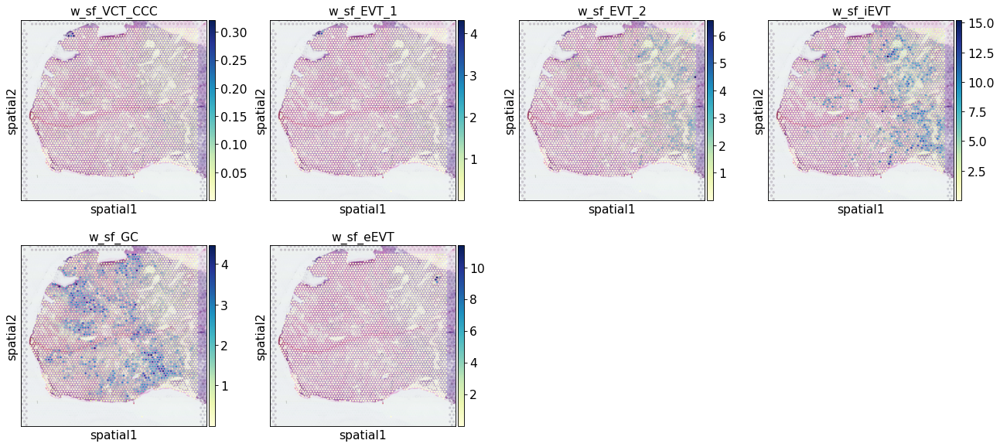

... storing 'feature_types' as categorical
... storing 'genome' as categorical


65


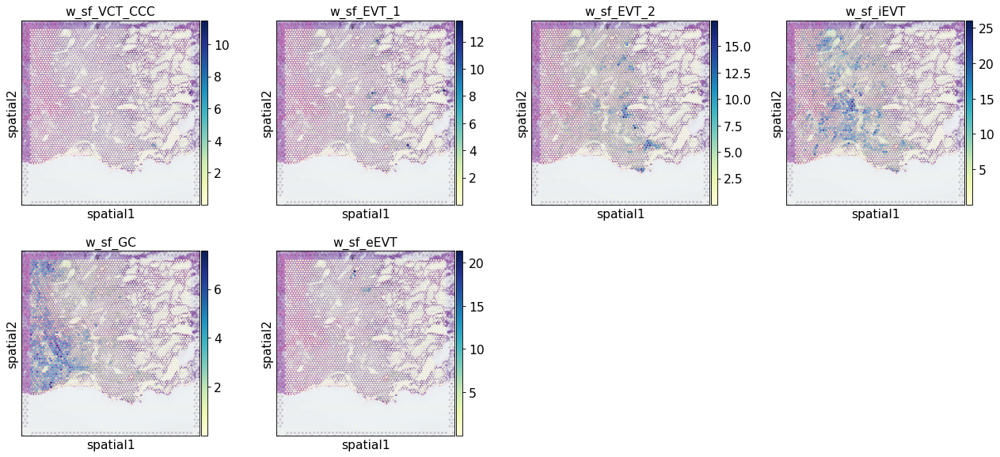

... storing 'feature_types' as categorical
... storing 'genome' as categorical


66


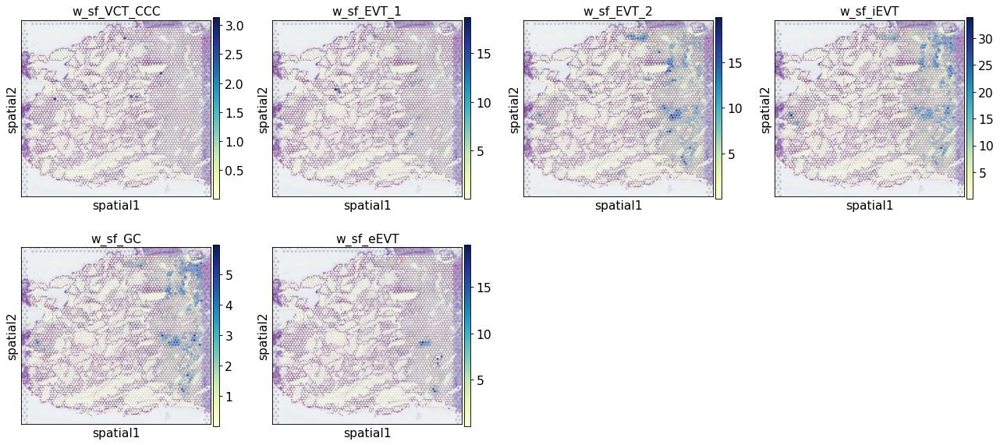

... storing 'feature_types' as categorical
... storing 'genome' as categorical


67


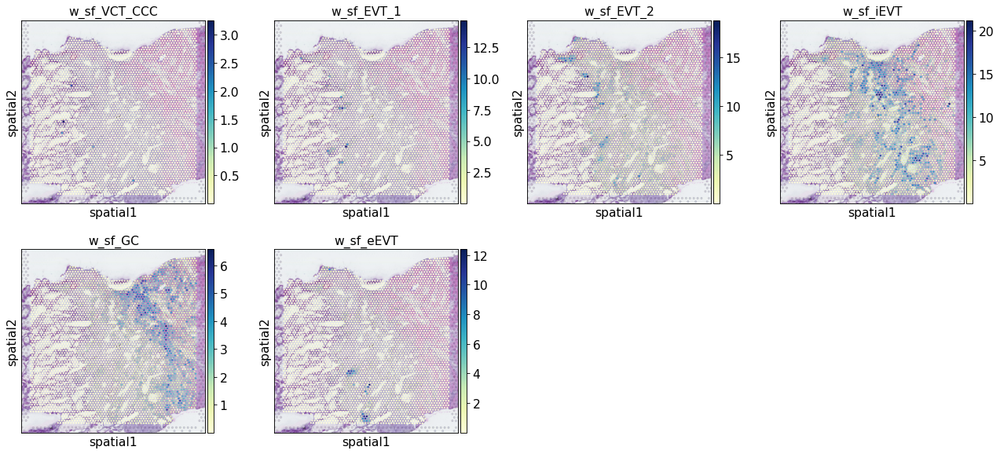

In [17]:
# plot

for ID in IDs_P13:
    print(ID)
    sc.pl.spatial(adatas_P13[ID],
                 color = ['w_sf_VCT_CCC','w_sf_EVT_1','w_sf_EVT_2','w_sf_iEVT','w_sf_GC', 'w_sf_eEVT'], cmap='YlGnBu', 
                  #save='_ID_' + ID + '_iEVT_c2l_density.pdf'
                 )

In [19]:
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42

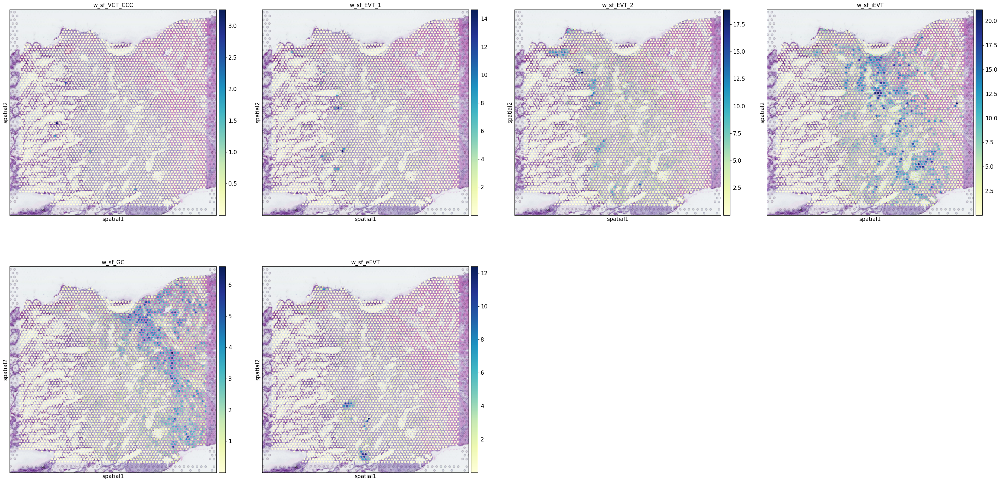

In [18]:
# zoom ins of chip 67 for Fig.1F

sc.set_figure_params(figsize=(10,10))

sc.pl.spatial(adatas_P13['67'],
                 color = ['w_sf_VCT_CCC','w_sf_EVT_1','w_sf_EVT_2','w_sf_iEVT','w_sf_GC', 'w_sf_eEVT'], cmap='YlGnBu', 
                  #save='_ID_' + ID + '_c2l_density_.pdf'
                 )


64


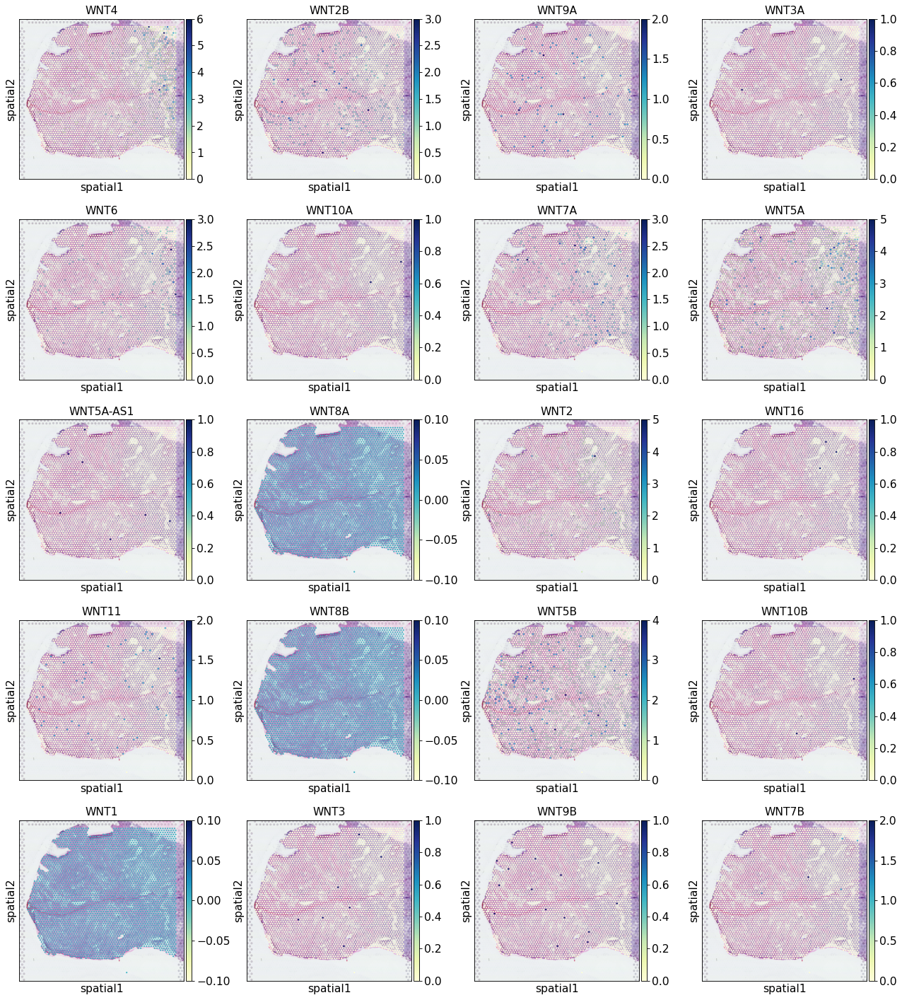

65


In [ ]:
# plot WNT 

for ID in IDs_P13:
    print(ID)
    sc.pl.spatial(adatas_P13[ID],
                 color = [elem for elem in adatas_P13[ID].var_names if 'WNT' in elem], cmap='YlGnBu', 
                  #save='_ID_' + ID + '_iEVT_c2l_density.pdf'
                 )

... storing 'feature_types' as categorical
... storing 'genome' as categorical


64


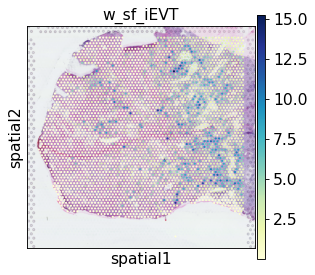

... storing 'feature_types' as categorical
... storing 'genome' as categorical


65


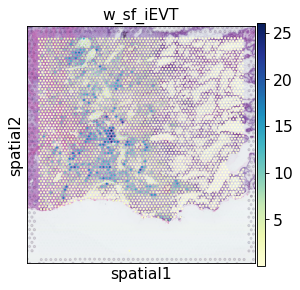

... storing 'feature_types' as categorical
... storing 'genome' as categorical


66


In [ ]:
# plot

for ID in IDs_P13:
    print(ID)
    sc.pl.spatial(adatas_P13[ID],
                 color = ['w_sf_iEVT'], cmap='YlGnBu', save='_ID_' + ID + '_iEVT_c2l_density.pdf')